In [44]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation as LDA
import plotly_express as px

from sklearn.decomposition import PCA
from sklearn.preprocessing import normalize

In [3]:
pd.set_option('display.max_colwidth', None)
import configparser
config = configparser.ConfigParser()
config.read('env.ini')
data_home = config['DEFAULT']['data_home']
output_dir = config['DEFAULT']['output_dir']

In [4]:
data_prefix = 'entrepreneur'
colors = "YlGnBu"

In [5]:
ngram_range = (1, 2)
n_terms = 4000
n_topics = 40
max_iter = 20
n_top_terms = 9

OHCO = ['screenplay_id', 'scene_id', 'para_num', 'sent_num', 'token_num']
PARA = OHCO[:3]
SCENE = OHCO[:2]
SCREENPLAY = OHCO[:1]

In [6]:
BAG = SCENE
import warnings
warnings.filterwarnings('ignore')

In [7]:
TOKENS = pd.read_csv(f'{output_dir}/{data_prefix}-TOKEN.csv').set_index(OHCO)
TOKENS.head()

pos_tuple pos  \
screenplay_id scene_id para_num sent_num token_num                          
joy           1        0        0        0              ('The', 'DT')  DT   
                                         1          ('kitchen', 'NN')  NN   
                                         2               ('of', 'IN')  IN   
                                         3                ('a', 'DT')  DT   
                                         4            ('drive', 'NN')  NN   

                                                   token_str term_str  \
screenplay_id scene_id para_num sent_num token_num                      
joy           1        0        0        0               The      the   
                                         1           kitchen  kitchen   
                                         2                of       of   
                                         3                 a        a   
                                         4             drive    drive   

                                                   pos_group  
screenplay_id scene_id para_num sent_num token_num            
joy           1        0        0        0                DT  
                                         1                NN  
                                         2                IN  
                                         3                DT  
                                         4                NN

# Prep for LDA

In [8]:
DOCS = TOKENS[TOKENS.pos.str.match(r'^NNS?$')]\
    .groupby(BAG).term_str\
    .apply(lambda x: ' '.join(map(str,x)))\
    .to_frame()\
    .rename(columns={'term_str':'doc_str'})

In [9]:
count_engine = CountVectorizer(max_features=n_terms, ngram_range=ngram_range, stop_words='english')
count_model = count_engine.fit_transform(DOCS.doc_str)
TERMS = count_engine.get_feature_names_out()

In [10]:
VOCAB = pd.DataFrame(index=TERMS)
VOCAB.index.name = 'term_str'

In [11]:
DTM = pd.DataFrame(count_model.toarray(), index=DOCS.index, columns=TERMS)
DTM

05  1350000  aback  ability  absorbing  access  \
screenplay_id      scene_id                                                   
joy                1          0        0      0        0          0       0   
                   2          0        0      0        1          0       0   
                   4          0        0      0        0          0       0   
                   6          0        0      0        0          0       0   
                   7          0        0      0        0          0       0   
...                          ..      ...    ...      ...        ...     ...   
the_social_network 569        0        0      0        0          0       0   
                   572        0        0      0        0          0       0   
                   573        0        0      0        0          0       0   
                   574        0        0      0        0          0       0   
                   575        0        0      0        0          0       0   

                             account  accounts  acre  act  ...  youll  youre  \
screenplay_id      scene_id                                ...                 
joy                1               0         0     0    0  ...      0      0   
                   2               0         0     0    0  ...      0      0   
                   4               0         0     0    0  ...      0      0   
                   6               0         0     0    0  ...      0      0   
                   7               0         0     0    0  ...      0      0   
...                              ...       ...   ...  ...  ...    ...    ...   
the_social_network 569             0         0     0    0  ...      0      0   
                   572             0         0     0    0  ...      0      0   
                   573             0         0     0    0  ...      0      0   
                   574             0         0     0    0  ...      0      1   
                   575             0         0     0    0  ...      0      0   

                             youre beat  youre gonna  youre right  youve  \
screenplay_id      scene_id                                                
joy                1                  0            0            0      0   
                   2                  0            0            0      0   
                   4                  0            0            0      0   
                   6                  0            0            0      0   
                   7                  0            0            0      0   
...                                 ...          ...          ...    ...   
the_social_network 569                0            0            0      0   
                   572                0            0            0      0   
                   573                0            0            0      1   
                   574                0            0            0      0   
                   575                0            0            0      0   

                             yule  zero  òmó  ôem  
screenplay_id      scene_id                        
joy                1            0     0    0    0  
                   2            0     0    0    0  
                   4            0     0    0    0  
                   6            0     0    0    0  
                   7            0     0    0    0  
...                           ...   ...  ...  ...  
the_social_network 569          0     0    0    0  
                   572          0     0    0    0  
                   573          0     0    0    0  
                   574          0     0    0    0  
                   575          0     0    0    0  

[1846 rows x 4000 columns]

In [12]:
VOCAB['doc_count'] = DTM.astype('bool').astype('int').sum()
DOCS['term_count'] = DTM.sum(1)

In [13]:
DOCS.term_count.describe()

count    1846.000000
mean       14.210184
std        13.311210
min         0.000000
25%         4.000000
50%        11.000000
75%        21.000000
max       110.000000
Name: term_count, dtype: float64

In [14]:
lda_engine = LDA(n_components=n_topics, max_iter=max_iter, learning_offset=50., random_state=0)

In [15]:
TNAMES = [f"T{str(x).zfill(len(str(n_topics)))}" for x in range(n_topics)]

In [16]:
lda_model = lda_engine.fit_transform(count_model)

## THETA

In [17]:
THETA = pd.DataFrame(lda_model, index=DOCS.index)
THETA.columns.name = 'topic_id'
THETA.columns = TNAMES

In [18]:
THETA.sample(10).T.style.background_gradient(cmap=colors, axis=None)

## PHI

In [19]:
PHI = pd.DataFrame(lda_engine.components_, columns=TERMS, index=TNAMES)
PHI.index.name = 'topic_id'
PHI.columns.name = 'term_str'

In [20]:
PHI.T.sample(10).style.background_gradient(cmap=colors, axis=None)

topic_id,T00,T01,T02,T03,T04,T05,T06,T07,T08,T09,T10,T11,T12,T13,T14,T15,T16,T17,T18,T19,T20,T21,T22,T23,T24,T25,T26,T27,T28,T29,T30,T31,T32,T33,T34,T35,T36,T37,T38,T39
term_str,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
stores area,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,2.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000
life saying,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,2.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000
mirror,0.025000,0.025000,1.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,1.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,3.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,1.025000,0.025000
letterhead signature,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,2.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000
flags brothers,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,2.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000
growing,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,2.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,2.025000,0.025000,0.025000
cheek,0.025000,0.025000,2.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,2.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,1.025000,0.025000,0.025000,0.025000,0.025000
platter chicken,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,2.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000
supervising,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,2.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000,0.025000


## TOPICS

In [21]:
TOPICS = PHI.stack().groupby('topic_id')\
    .apply(lambda x: ' '.join(x.sort_values(ascending=False).head(n_top_terms).reset_index().term_str))\
    .to_frame('top_terms')

In [22]:
TOPICS.head()

,top_terms
topic_id,
T00,swaps sign place glass loans dont money golf default swaps
T01,right people book hand vo way arches building deal
T02,room kitchen living living room people house time way world
T03,vo school computer people money gonna brother right room
T04,contd sorry money men youre summers sir skeeter today


In [23]:
TOPICS['doc_weight_sum'] = THETA.sum()
TOPICS['term_freq'] = PHI.sum(1) / PHI.sum(1).sum()

In [24]:
TOPICS.sort_values('doc_weight_sum', ascending=False).style.background_gradient(cmap=colors)

,top_terms,doc_weight_sum,term_freq
topic_id,,,
T27,continued lot arches angles parking lot parking cover restaurant things,118.237774,0.025378
T19,bonds mortgage banks car mortgage bonds housing market mortgages shit,62.955227,0.042527
T30,computer room moment door skeeter conference hand hands time,57.578945,0.029280
T25,yule skeeter os door map phone table book desk,55.382689,0.026782
T09,door board house way man world time bed record,53.224913,0.028538
T15,people end dress vo day right way business party,52.469261,0.027682
T20,girls kitchen door room skeeter guys morning nods end,52.465449,0.030366
T16,os phone time right people ll door way bank,52.104587,0.030608
T06,thing gonna business people beat time summers youre milkshake,49.394011,0.032061


In [25]:
cols = TOPICS.columns[1:].to_list()
r = TOPICS[cols].corr().iloc[1,1]

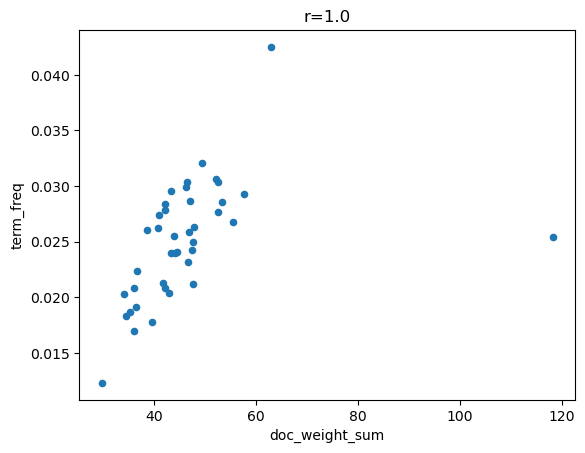

In [26]:
TOPICS.plot.scatter(*cols, title=f"r={r}");

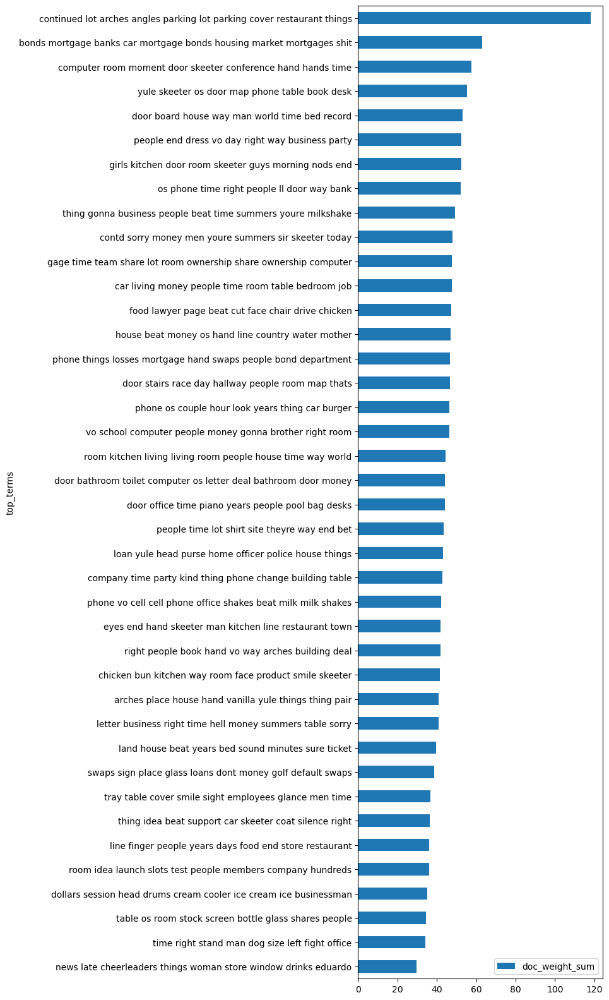

In [27]:
TOPICS.sort_values('doc_weight_sum', ascending=True).plot.barh(y='doc_weight_sum', x='top_terms', figsize=(5, n_topics/2));

## LDA + Visualizations

In [28]:
LIB = pd.read_csv(f'{output_dir}/{data_prefix}-LIB.csv').set_index('screenplay_id')

In [29]:
LIB['title_key'] = LIB.raw_title.str.split(', ').str[0].str.lower()

In [30]:
TITLES = sorted(LIB.title_key.value_counts().index.to_list())

In [31]:
TOPICS[TITLES] = THETA.join(LIB, on='screenplay_id').groupby('title_key')[TNAMES].mean().T

In [32]:
TOPICS[TITLES + ['top_terms']].style.background_gradient(cmap=colors, axis=None)

,joy,steve jobs,the big short,the founder,the help,the social network,top_terms
topic_id,,,,,,,
T00,0.026062,0.012994,0.034163,0.029206,0.018490,0.016646,swaps sign place glass loans dont money golf default swaps
T01,0.014143,0.022036,0.024812,0.017367,0.031259,0.024446,right people book hand vo way arches building deal
T02,0.024674,0.025316,0.027253,0.023974,0.033112,0.011998,room kitchen living living room people house time way world
T03,0.011629,0.032663,0.039859,0.011350,0.014803,0.034096,vo school computer people money gonna brother right room
T04,0.024664,0.020378,0.025004,0.023964,0.024454,0.037505,contd sorry money men youre summers sir skeeter today
T05,0.027775,0.028449,0.025132,0.028991,0.016570,0.024112,phone os couple hour look years thing car burger
T06,0.024883,0.029924,0.018924,0.024176,0.013333,0.042491,thing gonna business people beat time summers youre milkshake
T07,0.032812,0.013282,0.009825,0.035572,0.023684,0.041719,food lawyer page beat cut face chair drive chicken
T08,0.033579,0.020178,0.019383,0.036120,0.008286,0.017613,land house beat years bed sound minutes sure ticket


In [33]:
TOPICS['title'] = TOPICS[TITLES].idxmax(1)
TOPICS.sort_values(['title','doc_weight_sum'], ascending=[True,False]).style.background_gradient(cmap=colors)

,top_terms,doc_weight_sum,term_freq,joy,steve jobs,the big short,the founder,the help,the social network,title
topic_id,,,,,,,,,,
T39,car living money people time room table bedroom job,47.529435,0.024985,0.040322,0.023682,0.017657,0.039117,0.023590,0.016010,joy
T23,house beat money os hand line country water mother,46.924828,0.028691,0.033485,0.018882,0.031301,0.033236,0.024106,0.020884,joy
T35,door bathroom toilet computer os letter deal bathroom door money,44.089767,0.023956,0.029846,0.021929,0.021063,0.028980,0.028423,0.016429,joy
T34,arches place house hand vanilla yule things thing pair,40.998628,0.027419,0.025884,0.022744,0.009850,0.025145,0.025673,0.021171,joy
T36,tray table cover smile sight employees glance men time,36.700751,0.022375,0.037666,0.011187,0.009207,0.036547,0.019457,0.014496,joy
T26,thing idea beat support car skeeter coat silence right,36.357623,0.019120,0.032564,0.015063,0.010384,0.031609,0.020522,0.013597,joy
T29,line finger people years days food end store restaurant,36.117518,0.016992,0.028367,0.018597,0.010126,0.027548,0.019728,0.014765,joy
T27,continued lot arches angles parking lot parking cover restaurant things,118.237774,0.025378,0.025960,0.191956,0.009319,0.025218,0.014161,0.023927,steve jobs
T09,door board house way man world time bed record,53.224913,0.028538,0.014145,0.047853,0.031476,0.015724,0.027932,0.021780,steve jobs


In [35]:
from scipy.spatial.distance import pdist

In [36]:
tpairs_idx = [(a, b) for a, b in pd.MultiIndex.from_product([TOPICS.index, TOPICS.index]) if a < b]

In [37]:
TPAIRS = pd.DataFrame(tpairs_idx, columns=['topic_id_x', 'topic_id_y']).set_index(['topic_id_x', 'topic_id_y'])

In [38]:
TPAIRS['theta_cityblock'] = pdist(THETA.T, 'cityblock')
TPAIRS['theta_cosine'] = pdist(THETA.T, 'cosine')
TPAIRS['theta_canberra'] = pdist(THETA.T, 'canberra')
TPAIRS['theta_jaccard'] = pdist(THETA.T, 'jaccard')
TPAIRS['theta_js'] = pdist(THETA.T, 'jensenshannon')

In [39]:
TPAIRS['phi_cityblock'] = pdist(PHI, 'cityblock')
TPAIRS['phi_cosine'] = pdist(PHI, 'cosine')
TPAIRS['phi_canberra'] = pdist(PHI, 'canberra')
TPAIRS['phi_jaccard'] = pdist(PHI, 'jaccard')
TPAIRS['phi_js'] = pdist(PHI, 'jensenshannon')

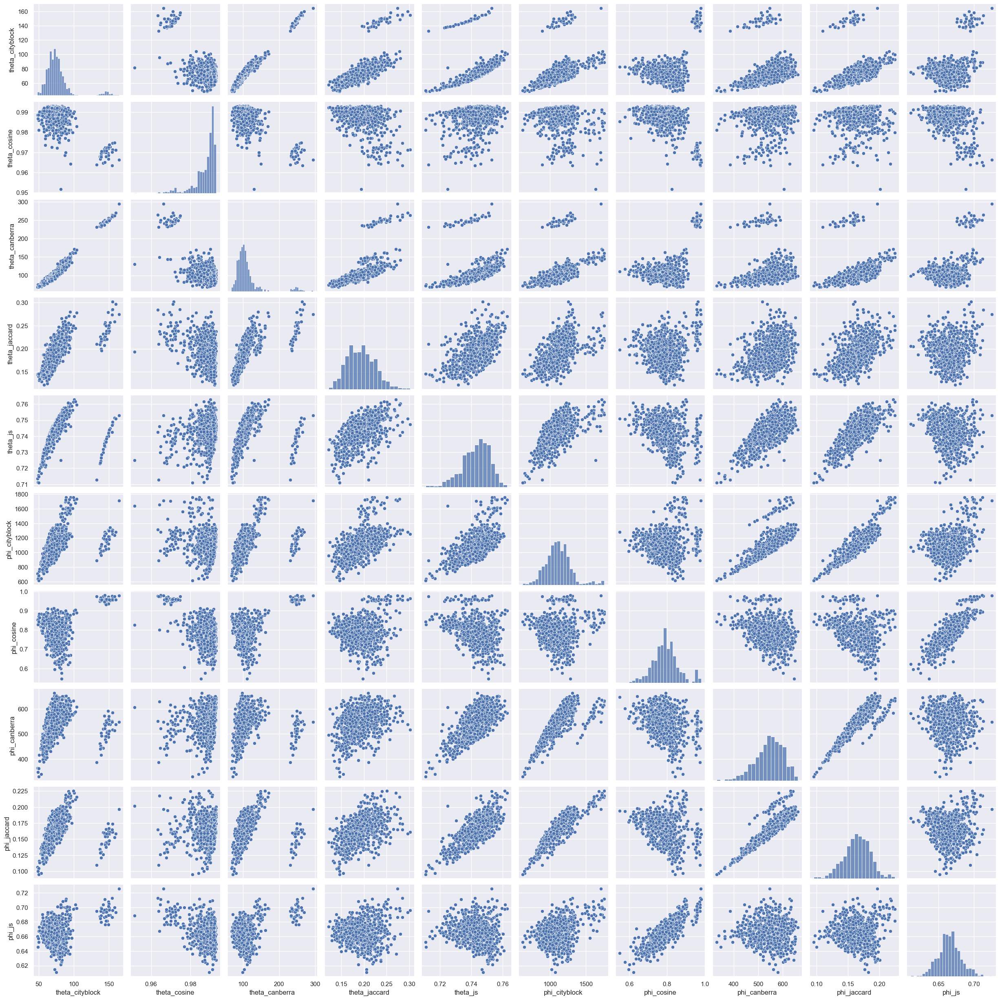

In [42]:
import pandas as pd
import numpy as np
import plotly_express as px
import seaborn as sns; sns.set()
sns.pairplot(TPAIRS);

## PHI PCA

In [64]:
pca_engine_phi = PCA(4)
PHI_COMPS = pd.DataFrame(pca_engine_phi.fit_transform(normalize(PHI, norm='l2', axis=1)), index=PHI.index)
TOPICS

,top_terms,doc_weight_sum,term_freq,joy,steve jobs,the big short,the founder,the help,the social network,title
topic_id,,,,,,,,,,
T00,swaps sign place glass loans dont money golf default swaps,38.663781,0.026031,0.026062,0.012994,0.034163,0.029206,0.018490,0.016646,the big short
T01,right people book hand vo way arches building deal,42.022960,0.020859,0.014143,0.022036,0.024812,0.017367,0.031259,0.024446,the help
T02,room kitchen living living room people house time way world,44.456282,0.024038,0.024674,0.025316,0.027253,0.023974,0.033112,0.011998,the help
T03,vo school computer people money gonna brother right room,46.253560,0.029903,0.011629,0.032663,0.039859,0.011350,0.014803,0.034096,the big short
T04,contd sorry money men youre summers sir skeeter today,47.866102,0.026326,0.024664,0.020378,0.025004,0.023964,0.024454,0.037505,the social network
T05,phone os couple hour look years thing car burger,46.445381,0.030379,0.027775,0.028449,0.025132,0.028991,0.016570,0.024112,the founder
T06,thing gonna business people beat time summers youre milkshake,49.394011,0.032061,0.024883,0.029924,0.018924,0.024176,0.013333,0.042491,the social network
T07,food lawyer page beat cut face chair drive chicken,47.381610,0.024287,0.032812,0.013282,0.009825,0.035572,0.023684,0.041719,the social network
T08,land house beat years bed sound minutes sure ticket,39.527795,0.017747,0.033579,0.020178,0.019383,0.036120,0.008286,0.017613,the founder


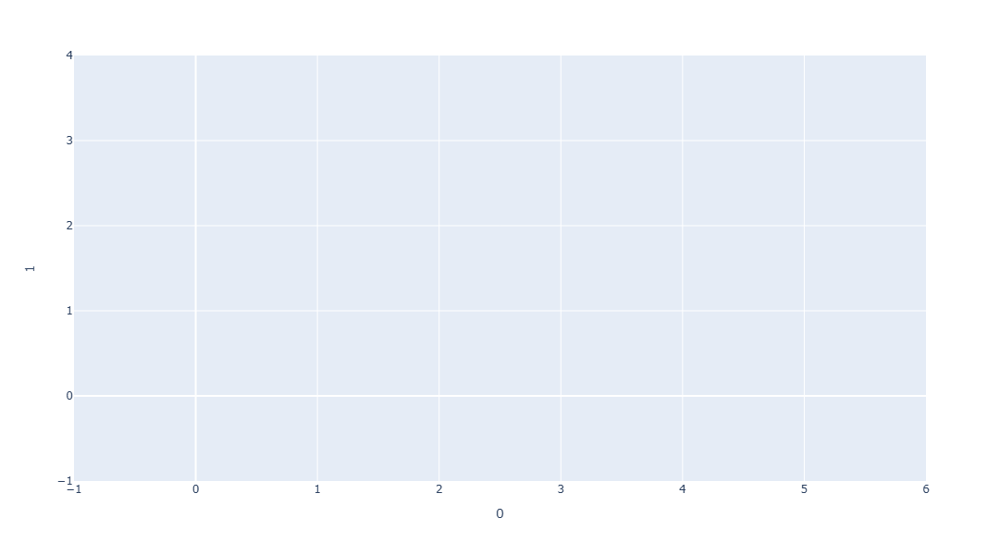

In [65]:
px.scatter(PHI_COMPS.reset_index(), 0, 1, 
           size=TOPICS.term_freq, 
           color=TOPICS.title, 
           text='topic_id', hover_name=TOPICS.doc_weight_sum, height=600, width=700)

In [66]:
PHI_LOADINGS = pd.DataFrame(pca_engine_phi.components_.T * np.sqrt(pca_engine_phi.explained_variance_), index=PHI.T.index)
PHI_LOADINGS.index.name = 'term_str'

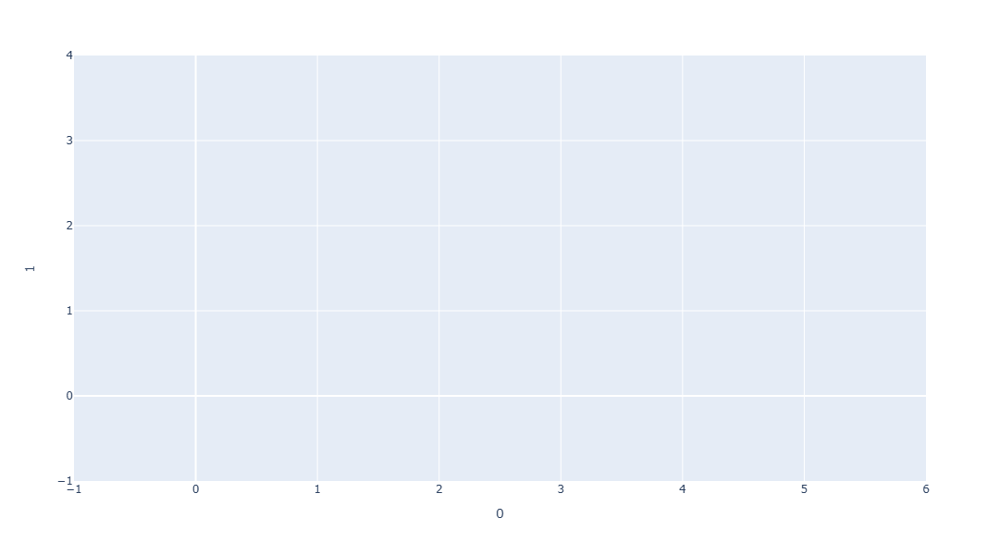

In [67]:
px.scatter(PHI_LOADINGS.reset_index(), 0, 1, text='term_str', height=600, width=700)

In [69]:
pca_engine_theta = PCA(5)

In [70]:
THETA_COMPS = pd.DataFrame(pca_engine_theta.fit_transform(normalize(THETA.T.values, norm='l2', axis=1)), index=THETA.T.index)
THETA_COMPS.index.name = 'topic_id'

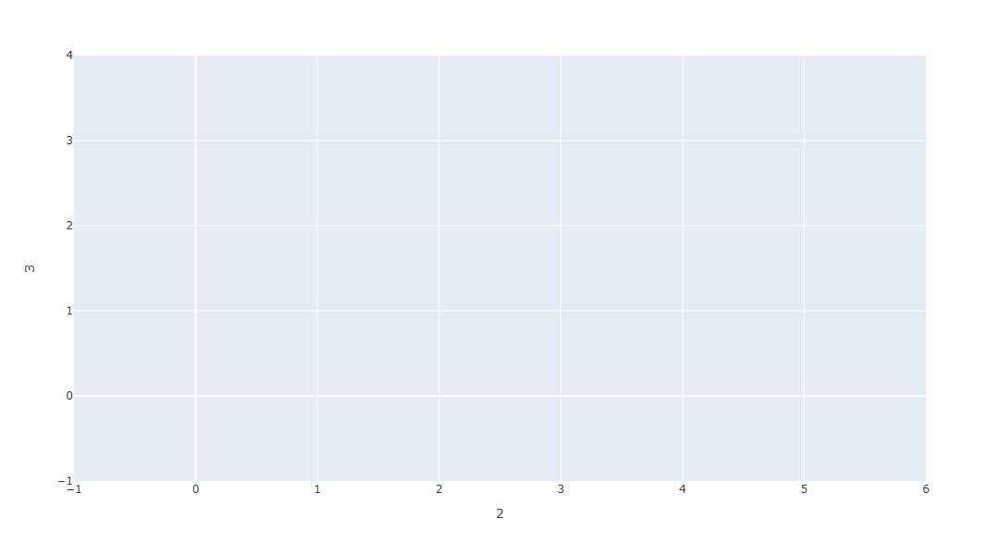

In [72]:
px.scatter(THETA_COMPS.reset_index(), 2, 3, 
           size=TOPICS.doc_weight_sum, color=TOPICS.title, 
           text='topic_id', hover_name=TOPICS.title, 
           height=600, width=700)

In [81]:
THETA_LOADINGS = pd.DataFrame(pca_engine_theta.components_.T * np.sqrt(pca_engine_theta.explained_variance_), index=THETA.index)
DOCS = pd.DataFrame(DOCS)
DOCS

doc_str  \
screenplay_id      scene_id                                                                                                                                                                                                                                                                                                                                 
joy                1                                                                                                                                                                                                                                                                                                         kitchen drive restaurant its   
                   2             sample pitch thinking heck spindle for shakes spindleó wrong notion chicken egg here milk shakes milk shakes latter customers order shake establishment its wait before again brand drive motor ability milk shakes mark dollars suckers stick at demand egg logic course bright fella idea beat say thoughtfully anyway   
                   4                                                                                                                                                                                                                                                                                                                       car trunk back   
                   6                                                                                                                                                                                                                                                                                                                  car sales watch its   
                   7                                                                                                                                                                                                                                   car customer spot front vast assortment items beef sandwiches tamales peanut butter chili dogs etc   
...                                                                                                                                                                                                                                                                                                                                                   ...   
the_social_network 569                                                                                        cool control panic control someone move is news now you no them somebody somebody coke cause there right ice home phone shut moment package desk earlier paper wrapping box box brand business cards business cards it womans voice vo mark   
                   572                                                                                                                               conference room one left voice lights skyline picture windows her day yeah here mark company day salad something guy testimony myths devil now others steak office settlement agreement gonna settle   
                   573                                                                    yeah extra guys disclosure agreement word wife kids jury jury selection jury sees defendant hair likability practice law months jury story chicken werent sorority party night one police question it youve jury minutes animals drunk stupid blogging blogging   
                   574       them scheme things speeding ticket anybody computer minute problem help asshole youre coat briefcase exits computer name search box name picture 07 smiles mouse forth boxes ﬁadd box request friend clicks homepage waits response hits settlement dollars disclosure agreement sixth hits settlement name masthead founder   
                   575                                                                                                                                

In [85]:
DOCS['doc_label'] = DOCS.apply(lambda x: f"{LIB.loc[x.name[0]].raw_title}-{x.name[1]}", axis=1)
DOCS['screen_play'] = DOCS.apply(lambda x: f"{LIB.loc[x.name[0]].raw_title}", axis=1)
DOCS['n_chars'] = DOCS.doc_str.str.len()

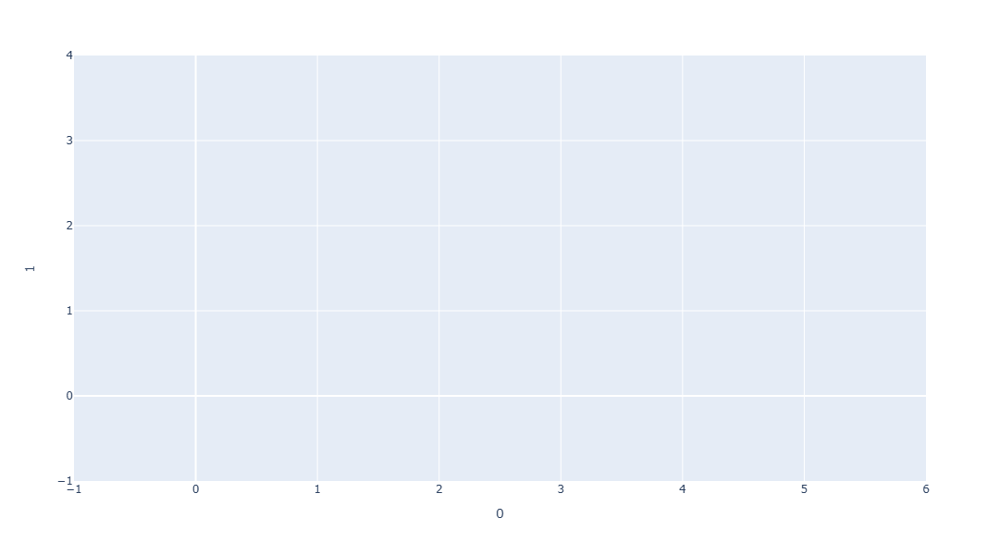

In [87]:
px.scatter(THETA_LOADINGS.reset_index(), 0, 1, 
           # size=DOCS.n_chars, 
           color=DOCS.screen_play, 
           height=600, width=900)

# Second Two Topics

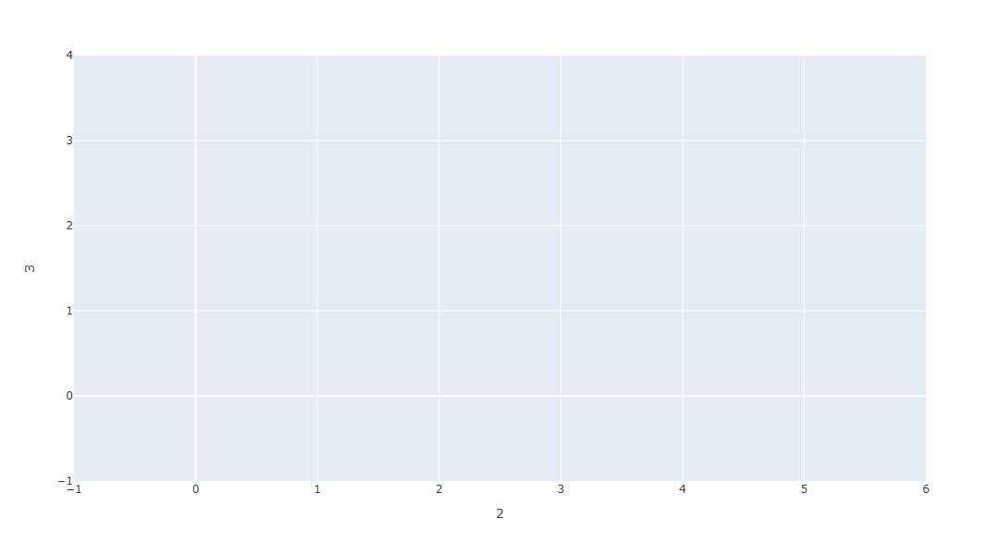

In [68]:
px.scatter(PHI_LOADINGS.reset_index(), 2, 3, text='term_str', height=600, width=700)

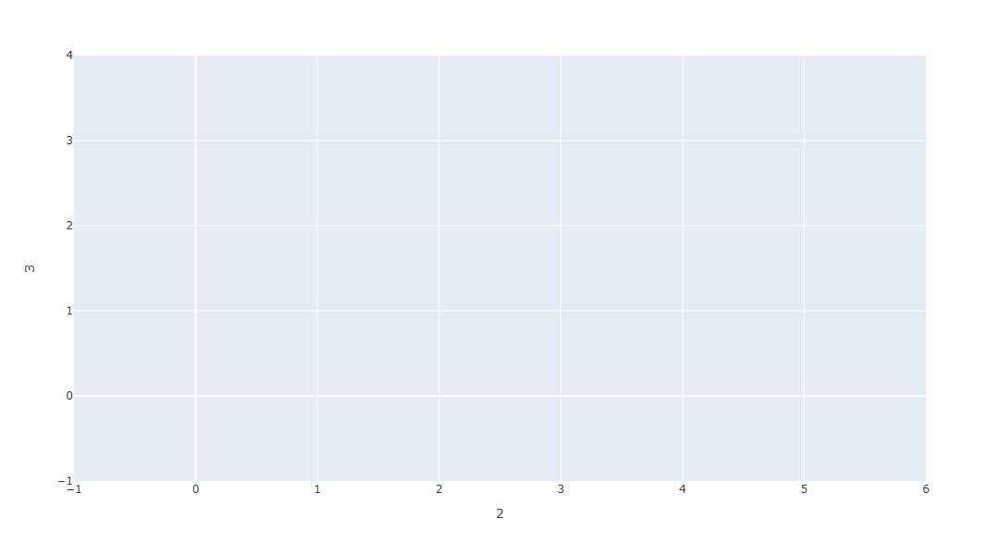

In [88]:
px.scatter(THETA_LOADINGS.reset_index(), 2, 3, 
           # size=DOCS.n_chars, 
           color=DOCS.screen_play, 
           height=600, width=900)

In [90]:
TPAIRS.to_csv(f"{output_dir}/{data_prefix}-TOPICPAIRS-{n_topics}.csv", index=True)
LIB.to_csv(f"{output_dir}/{data_prefix}-LIB-KEY.csv", index=True)
VOCAB.to_csv(f"{output_dir}/{data_prefix}-VOCAB2.csv", index=True)